### Github jobs skills counter

This notebook counts the number of jobs in which certain skills are mentioned using the github jobs API. 

- Edit the python list techs to add to the jobs counted.  
- Job skills are not mutually exclusive, so for example the job skill "C++" will also count the number of jobs in which "C" is mentioned. 
- The counter is text-based, so in order to count jobs in which "C" occurs not as a part of another word, include " C " in the list and not "C".  For example, the latter would count jobs contain the sentence. "Content writing experience required." since it contains "C".  Using " C " as a job skill would avoid this.  
- The counter counts the number of job listings and not the number of total mentions within all job listings.
- The counter may count one job listing twice.  For example, if a job description contains both "C++" and "Python", then one job would be counted under both categories.
- The counter is case sensitive

In [1]:
!pip install openpyxl
!pip install seaborn==0.11.1
from openpyxl import Workbook
import requests
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

/opt/conda/envs/Python-3.7-main/lib/python3.7/site-packages/secretstorage/dhcrypto.py:16: CryptographyDeprecationWarning: int_from_bytes is deprecated, use int.from_bytes instead
  from cryptography.utils import int_from_bytes
/opt/conda/envs/Python-3.7-main/lib/python3.7/site-packages/secretstorage/util.py:25: CryptographyDeprecationWarning: int_from_bytes is deprecated, use int.from_bytes instead
  from cryptography.utils import int_from_bytes
/opt/conda/envs/Python-3.7-main/lib/python3.7/site-packages/secretstorage/dhcrypto.py:16: CryptographyDeprecationWarning: int_from_bytes is deprecated, use int.from_bytes instead
  from cryptography.utils import int_from_bytes
/opt/conda/envs/Python-3.7-main/lib/python3.7/site-packages/secretstorage/util.py:25: CryptographyDeprecationWarning: int_from_bytes is deprecated, use int.from_bytes instead
  from cryptography.utils import int_from_bytes


In [2]:
sns.__version__

'0.11.1'

In [3]:
# the base usl for the github jobs page
baseurl = "https://jobs.github.com/positions.json"

In [4]:
# edit this list to change the skills searched for

techs = ['C%23', 'C++', 'Java', 'JavaScript', 'Python', 'Scala', 'Oracle', 'SQL Server', \
         'MySQL Server', 'PostgreSQL', 'MongoDB', 'Access', 'Advanced Excel', 'Excel', 'Agile', 'Scrum', \
        'AWS', 'Azure', 'DevOps', 'Basel', 'BigQuery', 'birst', 'data mining', 'Confluence', 'CRM', \
         'data analytics', 'data architecture', 'data visualization', 'Dax', 'DB2', 'DRY', 'Epic EMR', \
        'ETL', 'FOCUS', 'full stack', 'GCP', 'Git', 'Glue', 'Hadoop', 'HDFS', 'Hive', 'Hyperion', \
        'IDMS', 'Ignition', 'Jira', 'Jump', 'KISS', 'KPI Reporting', 'lambda', 'Linux', 'looker', \
        'noSQL', 'OOP', 'OBIEE', 'Pig', 'POS Data', 'Power BI', 'Power Query', 'PowerPoint', \
         'PowerPoint2', 'Qlikview', 'Redshift', 'relational database', 'REST API', 'Salesforce', \
        'SAP', 'SAS', 'SCADA', 'Shiny', 'Smartsheet', 'SQL', 'Subversion', 'Tableau', 'Unix', 'VBA', \
        'Workday', 'XML']
techs = sorted(techs)
techs

['AWS',
 'Access',
 'Advanced Excel',
 'Agile',
 'Azure',
 'Basel',
 'BigQuery',
 'C%23',
 'C++',
 'CRM',
 'Confluence',
 'DB2',
 'DRY',
 'Dax',
 'DevOps',
 'ETL',
 'Epic EMR',
 'Excel',
 'FOCUS',
 'GCP',
 'Git',
 'Glue',
 'HDFS',
 'Hadoop',
 'Hive',
 'Hyperion',
 'IDMS',
 'Ignition',
 'Java',
 'JavaScript',
 'Jira',
 'Jump',
 'KISS',
 'KPI Reporting',
 'Linux',
 'MongoDB',
 'MySQL Server',
 'OBIEE',
 'OOP',
 'Oracle',
 'POS Data',
 'Pig',
 'PostgreSQL',
 'Power BI',
 'Power Query',
 'PowerPoint',
 'PowerPoint2',
 'Python',
 'Qlikview',
 'REST API',
 'Redshift',
 'SAP',
 'SAS',
 'SCADA',
 'SQL',
 'SQL Server',
 'Salesforce',
 'Scala',
 'Scrum',
 'Shiny',
 'Smartsheet',
 'Subversion',
 'Tableau',
 'Unix',
 'VBA',
 'Workday',
 'XML',
 'birst',
 'data analytics',
 'data architecture',
 'data mining',
 'data visualization',
 'full stack',
 'lambda',
 'looker',
 'noSQL',
 'relational database']

In [5]:
def get_number_of_jobs(technology, baseurl):
    number_of_jobs = 0
    pg = 1
    counter = 50
    while(counter == 50):
        url = baseurl + "?description=" + technology + "&page=" + str(pg)
        response2 = requests.get( url )
        jobsdata = response2.json()
        counter = len(jobsdata)
        for job in jobsdata:
            number_of_jobs += 1
        pg += 1
    if technology == 'C%23':
        technology = 'C#'
    return technology,number_of_jobs

In [6]:
wb = Workbook()
ws = wb.active

ws.append(['Technology', 'Number of jobs'])
for tech in techs:
    pair = get_number_of_jobs(tech, baseurl)
    print(pair[0], pair[1])
    ws.append([pair[0], pair[1]])

AWS 26
Access 20
Advanced Excel 4
Agile 29
Azure 17
Basel 0
BigQuery 0
C# 13
C++ 89
CRM 3
Confluence 0
DB2 1
DRY 3
Dax 1
DevOps 22
ETL 6
Epic EMR 0
Excel 24
FOCUS 23
GCP 4
Git 59
Glue 0
HDFS 0
Hadoop 3
Hive 0
Hyperion 0
IDMS 0
Ignition 0
Java 33
JavaScript 24
Jira 5
Jump 0
KISS 0
KPI Reporting 0
Linux 16
MongoDB 4
MySQL Server 7
OBIEE 0
OOP 10
Oracle 4
POS Data 37
Pig 0
PostgreSQL 6
Power BI 26
Power Query 1
PowerPoint 0
PowerPoint2 0
Python 25
Qlikview 0
REST API 18
Redshift 0
SAP 5
SAS 5
SCADA 0
SQL 37
SQL Server 14
Salesforce 0
Scala 15
Scrum 10
Shiny 1
Smartsheet 0
Subversion 1
Tableau 0
Unix 2
VBA 0
Workday 2
XML 4
birst 0
data analytics 8
data architecture 18
data mining 3
data visualization 3
full stack 18
lambda 7
looker 0
noSQL 5
relational database 4


In [7]:
#    for row in ws.iter_rows(min_row=1, max_col=2, values_only=True):
#        print(row)
    
for row in ws.iter_rows(values_only=True):
    print(row)

#for row in ws.values:
#    for value in row:
#        print(value)

('Technology', 'Number of jobs')
('AWS', 26)
('Access', 20)
('Advanced Excel', 4)
('Agile', 29)
('Azure', 17)
('Basel', 0)
('BigQuery', 0)
('C#', 13)
('C++', 89)
('CRM', 3)
('Confluence', 0)
('DB2', 1)
('DRY', 3)
('Dax', 1)
('DevOps', 22)
('ETL', 6)
('Epic EMR', 0)
('Excel', 24)
('FOCUS', 23)
('GCP', 4)
('Git', 59)
('Glue', 0)
('HDFS', 0)
('Hadoop', 3)
('Hive', 0)
('Hyperion', 0)
('IDMS', 0)
('Ignition', 0)
('Java', 33)
('JavaScript', 24)
('Jira', 5)
('Jump', 0)
('KISS', 0)
('KPI Reporting', 0)
('Linux', 16)
('MongoDB', 4)
('MySQL Server', 7)
('OBIEE', 0)
('OOP', 10)
('Oracle', 4)
('POS Data', 37)
('Pig', 0)
('PostgreSQL', 6)
('Power BI', 26)
('Power Query', 1)
('PowerPoint', 0)
('PowerPoint2', 0)
('Python', 25)
('Qlikview', 0)
('REST API', 18)
('Redshift', 0)
('SAP', 5)
('SAS', 5)
('SCADA', 0)
('SQL', 37)
('SQL Server', 14)
('Salesforce', 0)
('Scala', 15)
('Scrum', 10)
('Shiny', 1)
('Smartsheet', 0)
('Subversion', 1)
('Tableau', 0)
('Unix', 2)
('VBA', 0)
('Workday', 2)
('XML', 4)
('bi

In [8]:
wb.save('github-joblisting-skills-count')

In [9]:
import os
print(os.path.abspath('github-joblisting-skills-count'))

/home/wsuser/work/github-joblisting-skills-count


In [10]:
pd.set_option('display.max_rows', 500)
df_skills = pd.read_excel("github-joblisting-skills-count")
df_skills.sort_values(by=['Number of jobs'], inplace=True, ascending=False)
df_skills.reset_index(drop=True)

,Technology,Number of jobs
0,C++,89
1,Git,59
2,SQL,37
3,POS Data,37
4,Java,33
5,Agile,29
6,Power BI,26
7,AWS,26
8,Python,25
9,Excel,24


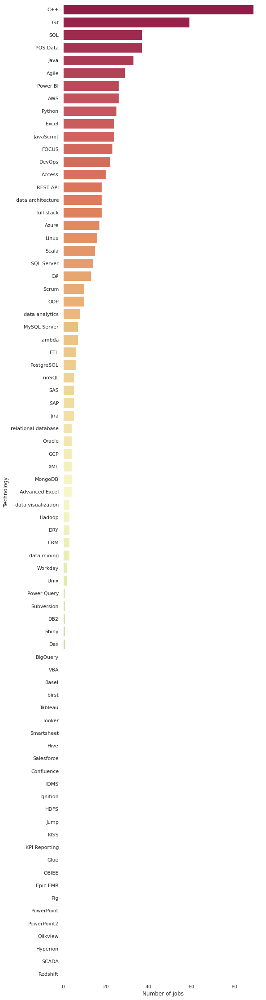

In [11]:
sns.set_theme(style="whitegrid")
sns.set(rc={'figure.figsize':(8, 40), 'axes.facecolor':'white'})
ax = sns.barplot(x="Number of jobs", y="Technology", data=df_skills, palette="Spectral")
sns.despine(left=True, bottom=True)

In [12]:
# the following cell imports the kaggle dataset listed as 'Developers and programming languages'
# https://www.kaggle.com/jaimevalero/developers-and-programming-languages

In [13]:
# The code was removed by Watson Studio for sharing.

,user_id,assembly,batchfile,c,c#,c++,clojure,coffeescript,css,elixir,...,yeoman-generator,yii,yii2,youtube,zephir,zero-configuration,zeromq,zookeeper,zsh,zsh-configuration
0,007lva,0.0,0.0,0.0,0.0000,0.00000,0.000000,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,06wj,0.0,0.0,0.0,0.0171,0.00000,0.000000,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0bserver07,0.0,0.0,0.0,0.0000,0.00000,0.000000,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0rca,0.0,0.0,0.0,0.0000,0.00000,0.252336,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0x00A,0.0,0.0,0.0,0.0000,0.10231,0.000000,0.0,0.005776,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [14]:
techs_1 = list(df.columns)
techs_1.pop(0)
techs_1.remove('c')
techs_1.remove('c#')

In [15]:
wb1 = Workbook()
ws1 = wb1.active

ws1.append(['Technology', 'Number of jobs'])
for tech in techs_1:
    pair = get_number_of_jobs(tech, baseurl)
    print(pair[0], pair[1])
    ws1.append([pair[0], pair[1]])

assembly 1
batchfile 0
c++ 89
clojure 2
coffeescript 0
css 12
elixir 4
emacs lisp 0
go 70
haskell 0
html 16
java 33
javascript 24
jupyter notebook 0
kotlin 6
lua 12
matlab 0
objective-c 2
objective-c++ 2
ocaml 0
perl 1
php 7
powershell 7
purebasic 0
python 25
rascal 0
ruby 9
rust 11
scala 15
shell 7
swift 4
tex 8
typescript 9
vim script 0
vue 6
1-wire 0
2d 9
3d 12
3d-engine 0
3d-game-engine 0
accessibility 3
accordion 0
acme 0
acme-client 0
activejob 0
activerecord 0
activity 5
activity-stream 0
actor-model 0
adc 2
addons 0
admin 11
admin-dashboard 0
admin-template 0
admin-theme 0
admin-ui 0
ado-net 0
adobe 0
after-effects 0
ag 88
agc 5
agent 4
airbnb 0
airtable 0
akka 0
alarm 0
alerting 0
algorithm 7
algorithm-challenges 0
algorithm-competitions 0
alignment 2
amd 0
analytics 11
android 7
android-application 0
android-architecture 0
android-cleanarchitecture 0
android-development 0
android-interview-questions 0
android-library 0
android-testing 0
android-ui 0
angular 9
angular-2 0
angu

In [16]:
wb1.save('skills-count-1411')
import os
print(os.path.abspath('skills-count-1411'))

/home/wsuser/work/skills-count-1411


In [17]:
pd.set_option('display.max_rows', 500)
df_skills_1411 = pd.read_excel("skills-count-1411")
df_skills_1411.sort_values(by=['Number of jobs'], inplace=True, ascending=False)
df_skills_1411.reset_index(drop=True)

,Technology,Number of jobs
0,c++,89
1,io,89
2,ag,88
3,bi,86
4,app,83
...,...,...
1403,hud,0
1404,hugo,0
1405,hyperscript,0
1406,hyperterm,0


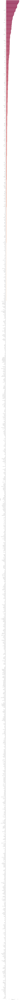

In [18]:
sns.set_theme(style="whitegrid")
sns.set(rc={'figure.figsize':(8, 600), 'axes.facecolor':'white'})
ax = sns.barplot(x="Number of jobs", y="Technology", data=df_skills_1411, palette="Spectral")
sns.despine(left=True, bottom=True)

In [19]:
# the following cell imports the kaggle dataset listed as 'List of all the skills'
# https://www.kaggle.com/arbazkhan971/allskillandnonskill

In [23]:

body = client_f8ba96dcb9e846b7902bb1f801e25c25.get_object(Bucket='project1-donotdelete-pr-gygbmwnnq7yf7f',Key='skills.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

df2 = pd.read_csv(body)
df2.head()


,Skill
0,supply chain engineering\n
1,bullet\n
2,commutations\n
3,pay equity\n
4,student retention\n


In [25]:
skills = list(df2['Skill'])
skills = [x[:-1] for x in skills]
skills
#techs_1.pop(0)
#techs_1.remove('c')
#techs_1.remove('c#')

['supply chain engineering',
 'bullet',
 'commutations',
 'pay equity',
 'student retention',
 'pulsa',
 'hevacomp',
 'travel insurance',
 'payback',
 'soaps',
 'erdf',
 '3d simulation',
 '中級',
 'server side',
 'filemaker server',
 'model development',
 'nms',
 'cocomo',
 'building analysis',
 'cockpit',
 'mobile payments',
 'rédaction',
 'goniometer',
 'suitcase',
 'reverse osmosis',
 'certified ethical hacker (do not use deprecated)',
 'photojournalism',
 'job transition',
 'dynamic modeling',
 'paradox',
 'investment decisions',
 'ion exchange',
 'passivhaus',
 'vldb',
 'contao',
 'sequential art',
 'microdrainage',
 'startu',
 'letters of credit',
 'augmented reality',
 'eyed',
 'brand perception',
 'pattern making',
 'ethics',
 'rpc',
 'computer navigation',
 'plotters',
 'chaos management',
 'pysto',
 'ns2',
 'broadcasting',
 'direct tax',
 'qts',
 'it outsourcing',
 'light scattering',
 'numpy',
 'resolving issues',
 'protractor',
 'etl tools',
 'plant pathology',
 'vidéo & audi

In [26]:
wb3 = Workbook()
ws3 = wb3.active

ws3.append(['Technology', 'Number of jobs'])
for tech in skills:
    pair = get_number_of_jobs(tech, baseurl)
    print(pair[0], pair[1])
    ws3.append([pair[0], pair[1]])

supply chain engineering 1
bullet 1
commutations 0
pay equity 1
student retention 0
pulsa 0
hevacomp 0
travel insurance 0
payback 0
soaps 0
erdf 0
3d simulation 0
中級 0
server side 8
filemaker server 0
model development 12
nms 0
cocomo 0
building analysis 7
cockpit 0
mobile payments 0
rédaction 0
goniometer 0
suitcase 0
reverse osmosis 0
certified ethical hacker (do not use deprecated) 0
photojournalism 0
job transition 7
dynamic modeling 0
paradox 0
investment decisions 0
ion exchange 4
passivhaus 0
vldb 0
contao 0
sequential art 0
microdrainage 0
startu 7
letters of credit 0
augmented reality 0
eyed 0
brand perception 0
pattern making 4
ethics 2
rpc 3
computer navigation 0
plotters 0
chaos management 0
pysto 0
ns2 0
broadcasting 0
direct tax 1
qts 1
it outsourcing 0
light scattering 0
numpy 1
resolving issues 2
protractor 0
etl tools 4
plant pathology 0
vidéo & audio 7
family events 2
overclocking 0
installanywhere 0
bid processes 0
mental health law 2
installation design 3
cpci 0
in 

KeyboardInterrupt: 

In [27]:
# note that in the last pass though this notbook, the
# above operation did not have time to finish
# it was interrupted early to be able to get through
# this notebook.  Needs more time next time or more
# compute power

wb3.save('skills-count-35000')
import os
print(os.path.abspath('skills-count-35000'))

/home/wsuser/work/skills-count-35000


In [28]:
pd.set_option('display.max_rows', 500)
df_skills_35000 = pd.read_excel("skills-count-35000")
df_skills_35000.sort_values(by=['Number of jobs'], inplace=True, ascending=False)
df_skills_35000.reset_index(drop=True)

,Technology,Number of jobs
0,ers,89
1,t,89
2,c+,89
3,vi,89
4,r&s,89
...,...,...
16395,lithium,0
16396,surface grinding,0
16397,gazebos,0
16398,track-it,0


In [36]:
sns.set_theme(style="whitegrid")
sns.set(rc={'figure.figsize':(8, 900), 'axes.facecolor':'white'})
ax = sns.barplot(x="Number of jobs", y="Technology", data=df_skills_35000, palette="Spectral")
sns.despine(left=True, bottom=True)

/opt/conda/envs/Python-3.7-main/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 12467 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/opt/conda/envs/Python-3.7-main/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 12511 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/opt/conda/envs/Python-3.7-main/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 12517 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/opt/conda/envs/Python-3.7-main/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 12491 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/opt/conda/envs/Python-3.7-main/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 12465 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/opt/conda/envs/Python-3.7-main/lib/pyth

In [30]:
# next steps are to:
# 1.) find a better skills list these three are either too small or too general
# 2.) make this work with the indeed API like it now works with the github API
#     since github jobs is too limited
#     https://opensource.indeedeng.io/api-documentation/docs/oauth/2-legged-oauth/